In [403]:
import pandas as pd
from PIL import Image
import numpy as np
import os
import matplotlib.pyplot as plt
import seaborn as sns
import cv2

In [404]:
df = pd.read_csv('sensing_data.csv')

In [405]:
df

,Photo,Category
0,20230326_083059.jpg,Waste
1,JPEG_20230326_081626_7412875616219492764.jpg,Footpath Quality
2,JPEG_20230326_081721_5685216607167779334.jpg,Obstruction
3,JPEG_20230326_081816_5837223647912020748.jpg,Obstruction
4,20230326_082017.jpg,Obstruction
...,...,...
596,JPEG_20230326_133527_5305208701780412837.jpg,Encroachment
597,JPEG_20230326_133624_3963014280937201941.jpg,Encroachment
598,JPEG_20230326_133720_8238953998702825054.jpg,Encroachment
599,JPEG_20230326_133756_3983622008836291234.jpg,Footpath Quality


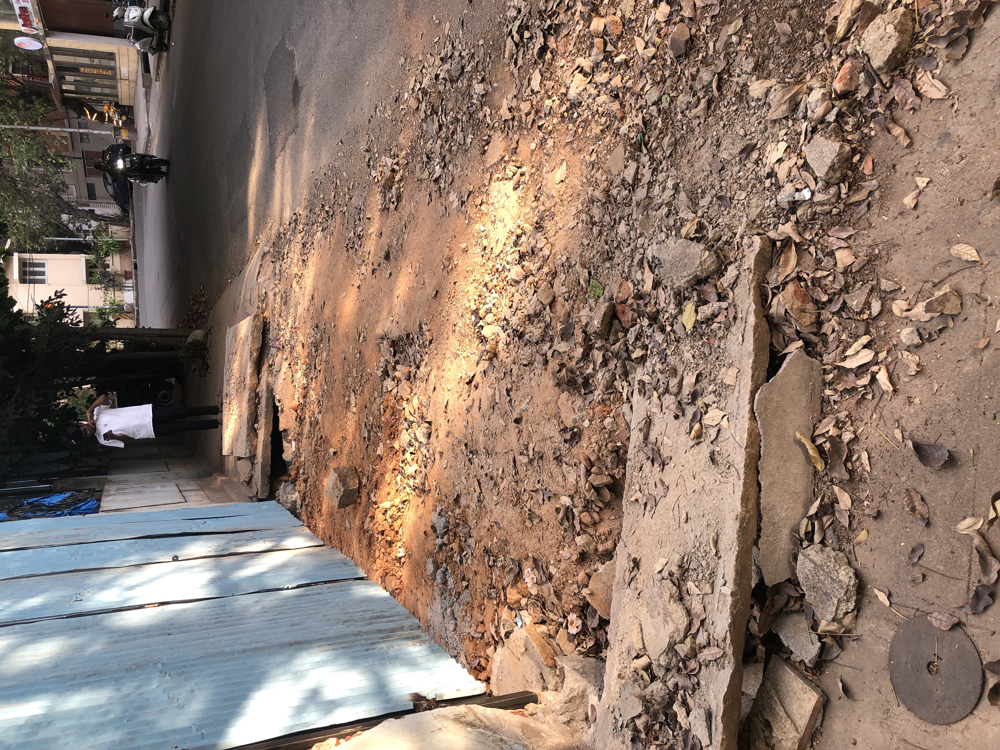

In [406]:
image = Image.open(r'Photos_WalkingAudit/20230323_171615.jpg')
image

In [408]:
images=[]

filenames=os.listdir("./Photos_WalkingAudit")
# dirp="./Photos_WalkingAudit/"
dirp="Photos_WalkingAudit/"

filenames
for f in filenames:
    path1 = dirp+f
    images.append(path1)
#     images+=load_images_from_folder(dirp+f,True,label=f)
#     if "jpg" in os.listdir(dirp+f)[0]:
# #     df['Photo']=os.listdir(r"./Photos_Walking Audit/{filename}")
#      df['Photo']=os.listdir()

In [409]:
images

['Photos_WalkingAudit/20230323_171615.jpg',
 'Photos_WalkingAudit/20230323_171701.jpg',
 'Photos_WalkingAudit/20230326_081641.jpg',
 'Photos_WalkingAudit/20230326_081702.jpg',
 'Photos_WalkingAudit/20230326_081831.jpg',
 'Photos_WalkingAudit/20230326_082010.jpg',
 'Photos_WalkingAudit/20230326_082017.jpg',
 'Photos_WalkingAudit/20230326_082022.jpg',
 'Photos_WalkingAudit/20230326_082038.jpg',
 'Photos_WalkingAudit/20230326_082051.jpg',
 'Photos_WalkingAudit/20230326_082103.jpg',
 'Photos_WalkingAudit/20230326_082116.jpg',
 'Photos_WalkingAudit/20230326_082137.jpg',
 'Photos_WalkingAudit/20230326_082140.jpg',
 'Photos_WalkingAudit/20230326_082153.jpg',
 'Photos_WalkingAudit/20230326_082206.jpg',
 'Photos_WalkingAudit/20230326_082215.jpg',
 'Photos_WalkingAudit/20230326_082226.jpg',
 'Photos_WalkingAudit/20230326_082228.jpg',
 'Photos_WalkingAudit/20230326_082238.jpg',
 'Photos_WalkingAudit/20230326_082246.jpg',
 'Photos_WalkingAudit/20230326_082247.jpg',
 'Photos_WalkingAudit/20230326_0

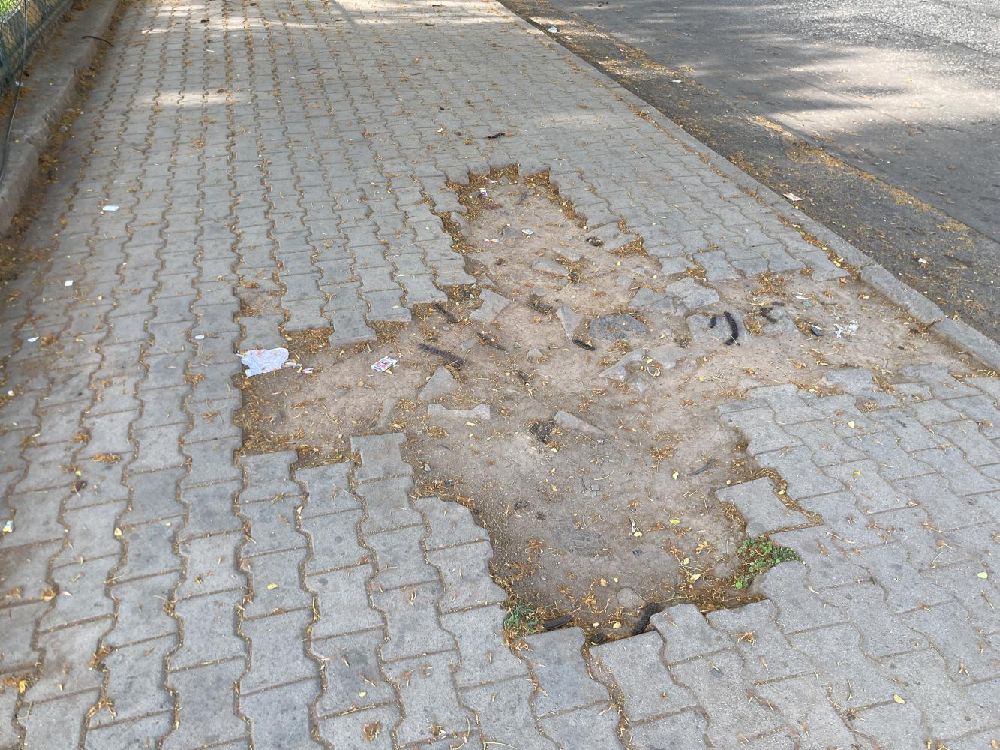

In [410]:
Image.open(images[2])

In [411]:
for i in images:
    df['Photo']=i

In [412]:
df

,Photo,Category
0,Photos_WalkingAudit/JPEG_20230326_133829_88488...,Waste
1,Photos_WalkingAudit/JPEG_20230326_133829_88488...,Footpath Quality
2,Photos_WalkingAudit/JPEG_20230326_133829_88488...,Obstruction
3,Photos_WalkingAudit/JPEG_20230326_133829_88488...,Obstruction
4,Photos_WalkingAudit/JPEG_20230326_133829_88488...,Obstruction
...,...,...
596,Photos_WalkingAudit/JPEG_20230326_133829_88488...,Encroachment
597,Photos_WalkingAudit/JPEG_20230326_133829_88488...,Encroachment
598,Photos_WalkingAudit/JPEG_20230326_133829_88488...,Encroachment
599,Photos_WalkingAudit/JPEG_20230326_133829_88488...,Footpath Quality


In [414]:
indexes = df[df['Category'] == 'Unsafe Zone'].index
print(indexes)

Index([129, 133, 151], dtype='int64')


In [415]:
df.drop(129,inplace=True)
df.drop(133,inplace=True)
df.drop(151,inplace=True)

In [416]:
from sklearn.utils import shuffle
df=shuffle(df,random_state=0)
df=df.reset_index(drop=True)

In [417]:
df

,Photo,Category
0,Photos_WalkingAudit/JPEG_20230326_133829_88488...,Waste
1,Photos_WalkingAudit/JPEG_20230326_133829_88488...,Waste
2,Photos_WalkingAudit/JPEG_20230326_133829_88488...,Footpath Quality
3,Photos_WalkingAudit/JPEG_20230326_133829_88488...,Footpath Quality
4,Photos_WalkingAudit/JPEG_20230326_133829_88488...,Encroachment
...,...,...
593,Photos_WalkingAudit/JPEG_20230326_133829_88488...,Footpath Quality
594,Photos_WalkingAudit/JPEG_20230326_133829_88488...,Waste
595,Photos_WalkingAudit/JPEG_20230326_133829_88488...,Footpath Quality
596,Photos_WalkingAudit/JPEG_20230326_133829_88488...,Footpath Quality


In [418]:
categories_name=sorted(df.Category.unique())
categories_name

['Encroachment', 'Footpath Quality', 'Obstruction', 'Waste']

In [419]:
categories_name=sorted(df.Category.unique())
mapper_categories=dict(zip(categories_name,[t for t in range(len(categories_name))]))
df["label" ]=df["Category"].map(mapper_categories)

In [420]:
df

,Photo,Category,label
0,Photos_WalkingAudit/JPEG_20230326_133829_88488...,Waste,3
1,Photos_WalkingAudit/JPEG_20230326_133829_88488...,Waste,3
2,Photos_WalkingAudit/JPEG_20230326_133829_88488...,Footpath Quality,1
3,Photos_WalkingAudit/JPEG_20230326_133829_88488...,Footpath Quality,1
4,Photos_WalkingAudit/JPEG_20230326_133829_88488...,Encroachment,0
...,...,...,...
593,Photos_WalkingAudit/JPEG_20230326_133829_88488...,Footpath Quality,1
594,Photos_WalkingAudit/JPEG_20230326_133829_88488...,Waste,3
595,Photos_WalkingAudit/JPEG_20230326_133829_88488...,Footpath Quality,1
596,Photos_WalkingAudit/JPEG_20230326_133829_88488...,Footpath Quality,1


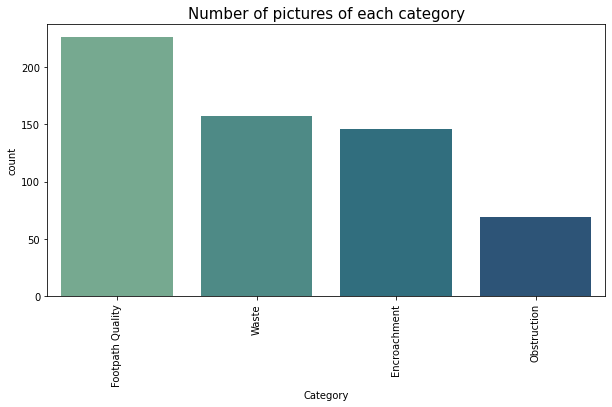

In [421]:
cc = df["Category"].value_counts()
plt.figure(figsize=(10,5))
sns.barplot(x = cc.index, y = cc, palette = "crest")
plt.title("Number of pictures of each category", fontsize = 15)
plt.xticks(rotation=90)
plt.show()

In [422]:
from tqdm import tqdm
# df_new = df.sample(frac = 0.5)
img_paths = df["Photo"].values
img_labels = df["label"].values
X = []
y = []

for i, path in tqdm(enumerate(img_paths), total=len(img_paths), desc="Loading images"):
    img = plt.imread(path)
    img = cv2.resize(img, (64, 64))
    label = img_labels[i]
    X.append(img)
    y.append(label)

X = np.array(X)
y = np.array(y)

Loading images: 100%|██████████| 598/598 [00:38<00:00, 15.56it/s]


In [423]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size= 0.20, random_state=21)
print(len(X_train))

478


In [424]:
# Define the number of classes/categories
num_classes = 4

In [310]:
# input_shape = (128, 128, 3)  

In [425]:
input_shape = (64, 64, 3)  
model = Sequential()

In [426]:
# Add the convolutional layers
model.add(Conv2D(32, kernel_size=(3, 3), activation='relu', input_shape=input_shape))
model.add(MaxPooling2D(pool_size=(2, 2)))

model.add(Conv2D(64, kernel_size=(3, 3), activation='relu'))
model.add(MaxPooling2D(pool_size=(2, 2)))

# Flatten the feature maps
model.add(Flatten())

In [427]:
# Add the fully connected layers
model.add(Dense(128, activation='relu'))
model.add(Dense(num_classes, activation='softmax'))

In [428]:
model.compile(optimizer='sgd', loss='categorical_crossentropy', metrics=['accuracy'])

In [429]:
# Print a summary of the model architecture
model.summary()

Model: "sequential_34"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_131 (Conv2D)         (None, 62, 62, 32)        896       
                                                                 
 max_pooling2d_131 (MaxPooli  (None, 31, 31, 32)       0         
 ng2D)                                                           
                                                                 
 conv2d_132 (Conv2D)         (None, 29, 29, 64)        18496     
                                                                 
 max_pooling2d_132 (MaxPooli  (None, 14, 14, 64)       0         
 ng2D)                                                           
                                                                 
 flatten_31 (Flatten)        (None, 12544)             0         
                                                                 
 dense_68 (Dense)            (None, 128)             

In [430]:
print(to_categorical(y_train))

[[0. 1. 0. 0.]
 [0. 1. 0. 0.]
 [0. 1. 0. 0.]
 ...
 [0. 0. 0. 1.]
 [0. 1. 0. 0.]
 [0. 0. 1. 0.]]


In [431]:
callbacks = [EarlyStopping(monitor='val_loss', patience=5),
             ModelCheckpoint(filepath='best_model.h5', monitor='val_loss', save_best_only=True)]
hists = []
y_train = to_categorical(y_train)
model.fit(X_train, y_train, batch_size=32, epochs=40, callbacks=callbacks, validation_split = 0.1, verbose = 1)
hists.append(model.history.history)

Epoch 1/40
14/14 [==============================] - 4s 162ms/step - loss: 756682802723815424.0000 - accuracy: 0.2953 - val_loss: 1.3850 - val_accuracy: 0.3542
Epoch 2/40
14/14 [==============================] - 2s 116ms/step - loss: 1.3818 - accuracy: 0.3884 - val_loss: 1.3805 - val_accuracy: 0.3542
Epoch 3/40
14/14 [==============================] - 2s 112ms/step - loss: 1.3769 - accuracy: 0.3884 - val_loss: 1.3762 - val_accuracy: 0.3542
Epoch 4/40
14/14 [==============================] - 2s 120ms/step - loss: 1.3721 - accuracy: 0.3884 - val_loss: 1.3723 - val_accuracy: 0.3542
Epoch 5/40
14/14 [==============================] - 1s 94ms/step - loss: 1.3678 - accuracy: 0.3884 - val_loss: 1.3687 - val_accuracy: 0.3542
Epoch 6/40
14/14 [==============================] - 1s 92ms/step - loss: 1.3639 - accuracy: 0.3884 - val_loss: 1.3653 - val_accuracy: 0.3542
Epoch 7/40
14/14 [==============================] - 2s 115ms/step - loss: 1.3602 - accuracy: 0.3884 - val_loss: 1.3620 - val_accuracy